# Image Classification Using CNN

### Importing Required Libraries

In [1]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import random
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model

import cv2
import os
import numpy as np
import argparse
import imutils
import cv2
import matplotlib.pyplot as plt
from imutils import paths
%matplotlib inline

import warnings
from tqdm import tqdm_notebook as tqdm
import itertools

import tensorflow as tf
print(tf.__version__)
warnings.filterwarnings("ignore")
SEED = 42   # set random seed

2.15.0


### Loading the data set

In [2]:
import os
os.chdir("/content/drive/MyDrive/Deep Learning Exam")

In [3]:
!dir

cnn_model_150.h5  dataset  Deep\ Learning\ Exam\ CNN.ipynb  test_examples


### CNN Model Architecture

In [4]:
# create CNN model
class LeNet:
    @staticmethod
    def build(width, height, depth, classes):

        # initialize the model
        model = Sequential()
        inputShape = (height, width, depth) # (h, h, channel)

        # if we are using "channels first", update the input shape
        if K.image_data_format() == "channels_first":
            inputShape = (depth, height, width)

        # first set of CONV => RELU => POOL layers
        model.add(Conv2D(20, (5,5), padding="same", input_shape=inputShape))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # second set of CONV => RELU => POOL layers
        model.add(Conv2D(50, (5,5), padding="same"))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # third set of CONV => RELU => POOL layers
        model.add(Conv2D(100, (5,5), padding="same", input_shape=inputShape))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # first (and only) set of FC => RELU layers
        model.add(Flatten())
        model.add(Dense(500))
        model.add(Activation("relu"))

        # softmax classifier
        model.add(Dense(classes))
        model.add(Activation("softmax"))

        # return the constructed network architecture
        return model

In [5]:
# initialize the data and labels
print("[INFO] loading images...")
data = []
labels = []

# grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images("dataset")))
random.seed(42)
random.shuffle(imagePaths)

# progress bar
with tqdm(total=len(imagePaths)) as pbar: # devdattasupnekar.ds@gmail.com

    # loop over the input images
    for idx, imagePath in enumerate(imagePaths):
        # load the image, pre-process it, and store it in the data list
        image = cv2.imread(imagePath)
        image = cv2.resize(image, (28, 28))
        image = img_to_array(image)
        data.append(image)

        # extract the class label from the image path and update the
        # labels list
        label = imagePath.split(os.path.sep)[-2]

        if label == "Boots":
            label = 0
        elif label == "Sandals":
            label = 1
        elif label == "Slippers":
            label = 2

        labels.append(label)

        # update the progressbar
        pbar.update(1)

[INFO] loading images...


  0%|          | 0/787 [00:00<?, ?it/s]

In [6]:
data[0].shape

(28, 28, 3)

In [7]:
data = np.array(data, dtype="float") / 255.0
labels = np.array(labels)

In [8]:
(trainX, testX, trainY, testY) = train_test_split(data, labels, test_size=0.25, random_state=42)

In [9]:
trainX.shape

(590, 28, 28, 3)

In [10]:
trainY.shape

(590,)

In [11]:
trainY = to_categorical(trainY, num_classes=3)
testY = to_categorical(testY, num_classes=3)

In [12]:
trainY[0]

array([0., 0., 1.], dtype=float32)

In [13]:
# Data Preprocessing (Augumentation)

In [14]:
# construct the image generator for data augmentation
aug = ImageDataGenerator(rotation_range=30,
                         width_shift_range=0.1,
                         height_shift_range=0.1,
                         shear_range=0.2,
                         zoom_range=0.2,
                         horizontal_flip=True,
                         fill_mode="nearest")

In [15]:
EPOCHS = 50
INIT_LR = 1e-3
BS = 32

# initialize the model
print("[INFO] compiling model...")
model = LeNet.build(width=28, height=28, depth=3, classes=3)
opt = Adam(lr=INIT_LR)

model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])
print("[INFO] model complied...")

[INFO] compiling model...


[INFO] model complied...


In [16]:
print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 20)        1520      
                                                                 
 activation (Activation)     (None, 28, 28, 20)        0         
                                                                 
 max_pooling2d (MaxPooling2  (None, 14, 14, 20)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 50)        25050     
                                                                 
 activation_1 (Activation)   (None, 14, 14, 50)        0         
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 7, 7, 50)          0         
 g2D)                                                   

In [17]:
# train the network

EPOCH  = 150
print("[INFO] training network...")
H = model.fit(x=aug.flow(trainX, trainY, batch_size=BS),
              validation_data=(testX, testY),
              steps_per_epoch=len(trainX) // BS,
              epochs=EPOCH,
              verbose=1)


# save the model and label binarizer to disk
print("[INFO] serializing network ...")
model.save("cnn_model_{}.h5".format(EPOCH))

[INFO] training network...
Epoch 1/150
18/18 [==============================] - 5s 57ms/step - loss: 1.0516 - accuracy: 0.4444 - val_loss: 0.8351 - val_accuracy: 0.6294
Epoch 2/150
18/18 [==============================] - 0s 22ms/step - loss: 0.8396 - accuracy: 0.6165 - val_loss: 0.5704 - val_accuracy: 0.7513
Epoch 3/150
18/18 [==============================] - 0s 20ms/step - loss: 0.7026 - accuracy: 0.6631 - val_loss: 0.5200 - val_accuracy: 0.7411
Epoch 4/150
18/18 [==============================] - 1s 28ms/step - loss: 0.5846 - accuracy: 0.7186 - val_loss: 0.5634 - val_accuracy: 0.7107
Epoch 5/150
18/18 [==============================] - 1s 33ms/step - loss: 0.6164 - accuracy: 0.7204 - val_loss: 0.4307 - val_accuracy: 0.7970
Epoch 6/150
18/18 [==============================] - 1s 36ms/step - loss: 0.5585 - accuracy: 0.7276 - val_loss: 0.3680 - val_accuracy: 0.9086
Epoch 7/150
18/18 [==============================] - 1s 37ms/step - loss: 0.5784 - accuracy: 0.7581 - val_loss: 0.3722 - 

### Model Evaluation

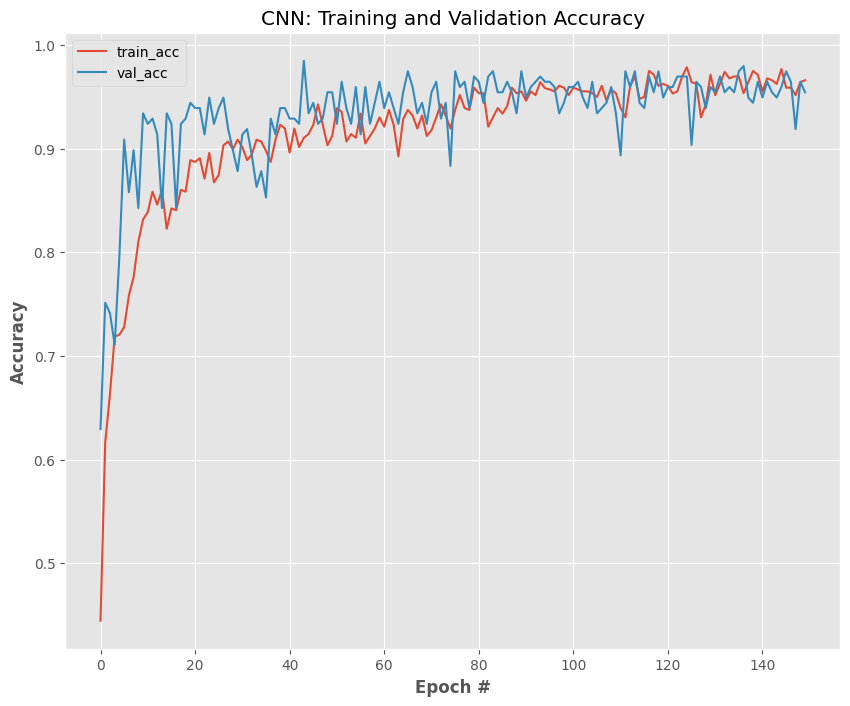

In [18]:
_# plot the training and validation accuracy
N = np.arange(0, 150)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["accuracy"], label="train_acc")
plt.plot(N, H.history["val_accuracy"], label="val_acc")
plt.title("CNN: Training and Validation Accuracy")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Accuracy", weight="bold")
plt.legend()
plt.show()

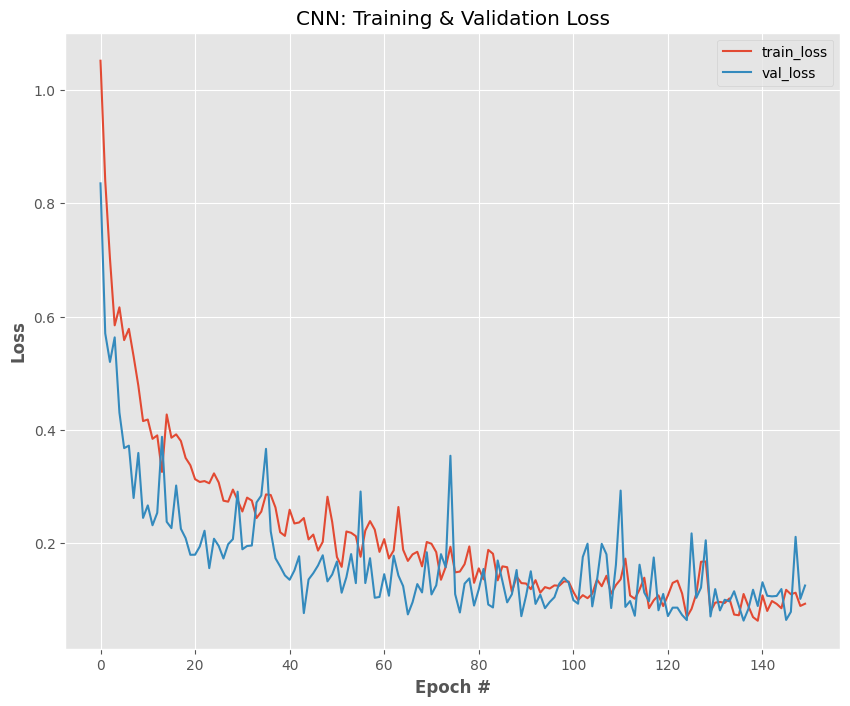

In [19]:
# plot the training and validation loss
N = np.arange(0, 150)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["loss"], label="train_loss")
plt.plot(N, H.history["val_loss"], label="val_loss")
plt.title("CNN: Training & Validation Loss")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Loss", weight="bold")
plt.legend()
plt.show()

### **Classification Report**

In [20]:
# Classification Report for the model on the training data
predictions = model.predict(testX, batch_size=BS)
predicted_labels = np.argmax(predictions, axis=1)
print(classification_report(testY.argmax(axis=1), predicted_labels))

7/7 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.99      0.95      0.97        84
           1       0.93      0.98      0.95        81
           2       0.94      0.91      0.92        32

    accuracy                           0.95       197
   macro avg       0.95      0.94      0.95       197
weighted avg       0.96      0.95      0.95       197



In [21]:
!dir

cnn_model_150.h5  dataset  Deep\ Learning\ Exam\ CNN.ipynb  test_examples


In [22]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    # plt.grid(b=None)
    ax = fig.add_subplot(111)
    ax.imshow(img)

In [23]:
# load the model
print("[INFO] loading network and...")
model = load_model("cnn_model_150.h5")

[INFO] loading network and...


  0%|          | 0/89 [00:00<?, ?it/s]

1/1 [==============================] - 0s 313ms/step
[3.1156024e-08 9.9986613e-01 1.3385237e-04]
1/1 [==============================] - 0s 24ms/step
[9.8874503e-01 1.1161055e-02 9.3988914e-05]
1/1 [==============================] - 0s 28ms/step
[9.9998891e-01 3.2907378e-06 7.7705854e-06]
1/1 [==============================] - 0s 24ms/step
[7.1443346e-06 2.5291852e-06 9.9999034e-01]
1/1 [==============================] - 0s 27ms/step
[9.99898434e-01 1.01566664e-04 4.53291227e-09]
1/1 [==============================] - 0s 18ms/step
[2.8099914e-04 9.9963331e-01 8.5697451e-05]
1/1 [==============================] - 0s 19ms/step
[1.0000000e+00 1.8457332e-08 4.7769795e-15]
1/1 [==============================] - 0s 16ms/step
[5.4745544e-07 9.9999917e-01 2.5049903e-07]
1/1 [==============================] - 0s 18ms/step
[5.5448967e-05 9.9927109e-01 6.7348272e-04]
1/1 [==============================] - 0s 20ms/step
[9.9999988e-01 1.4158147e-07 7.5212328e-16]
1/1 [==============================]

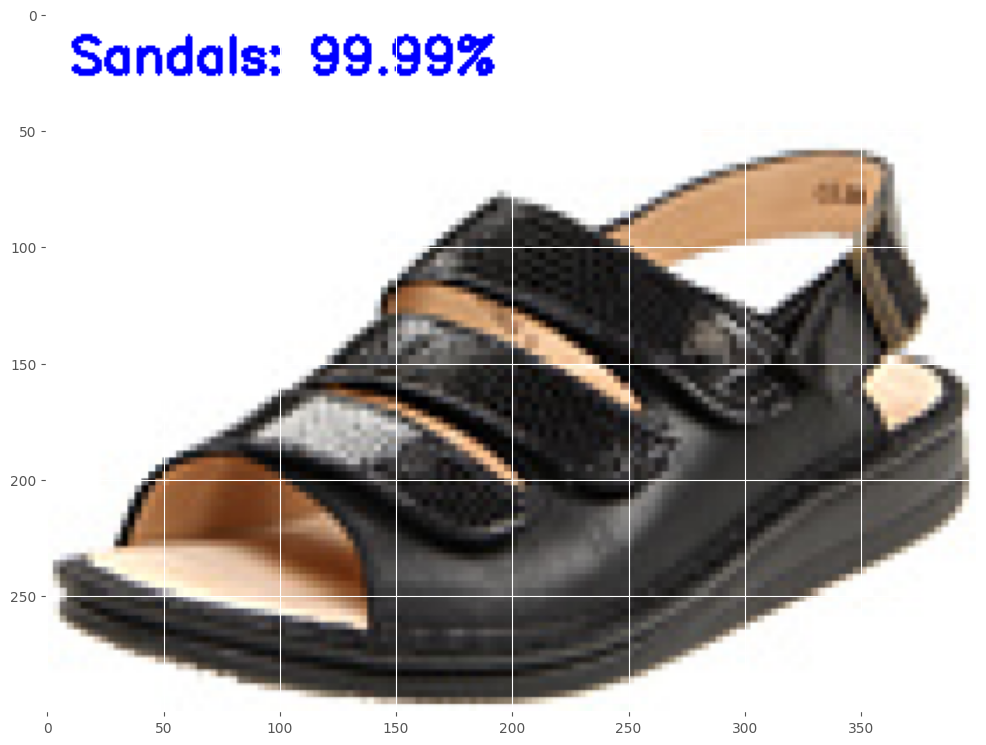

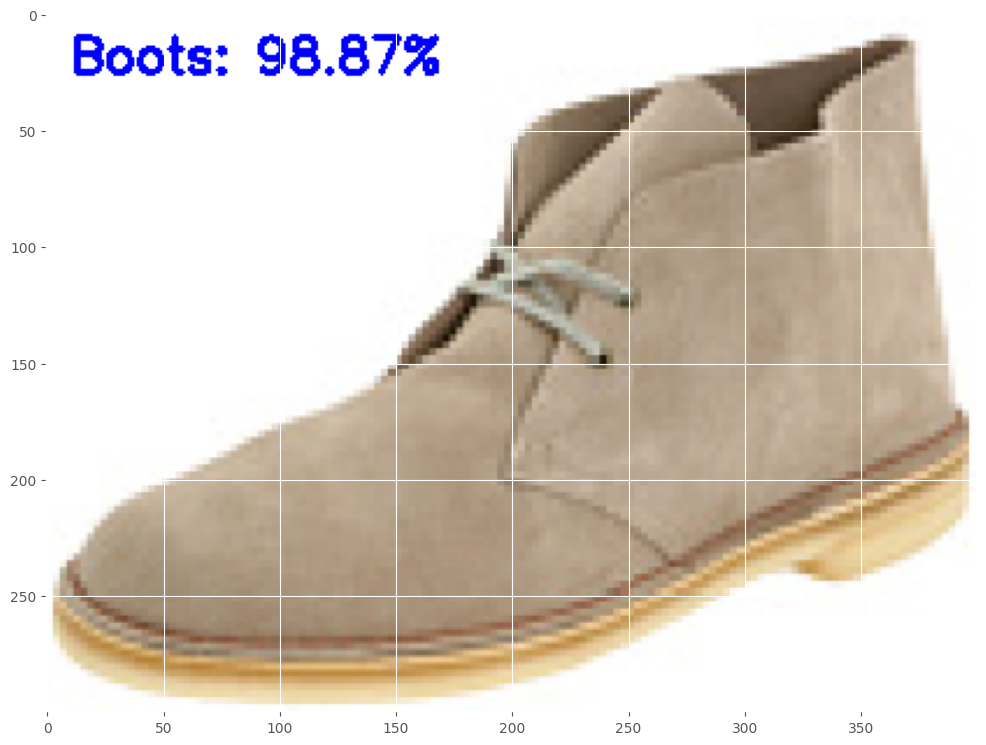

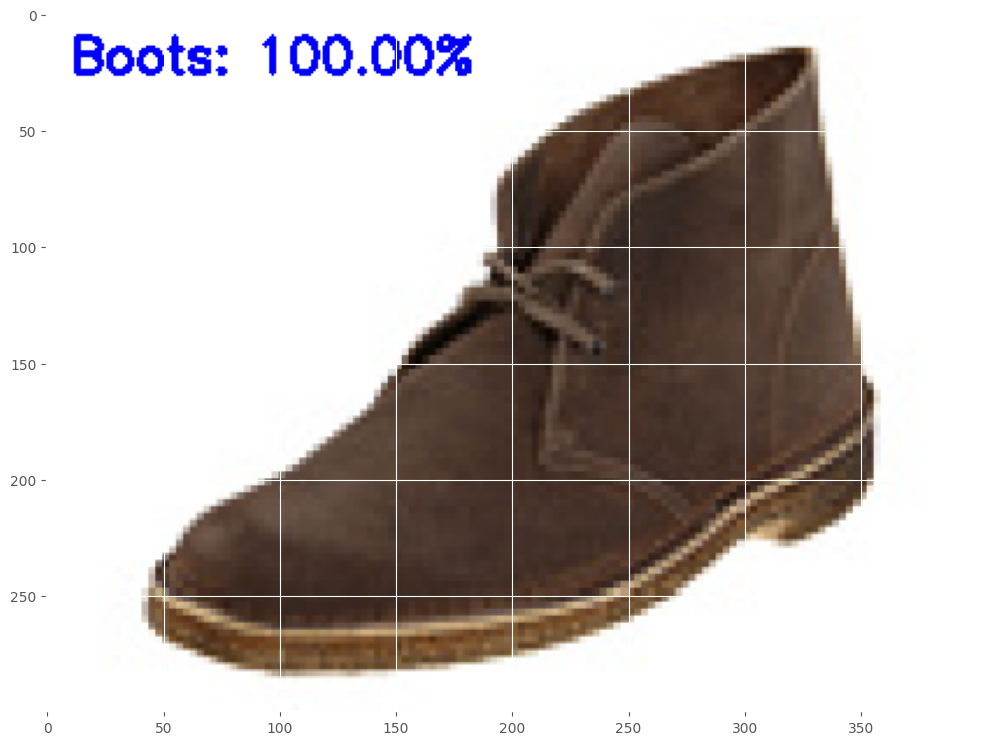

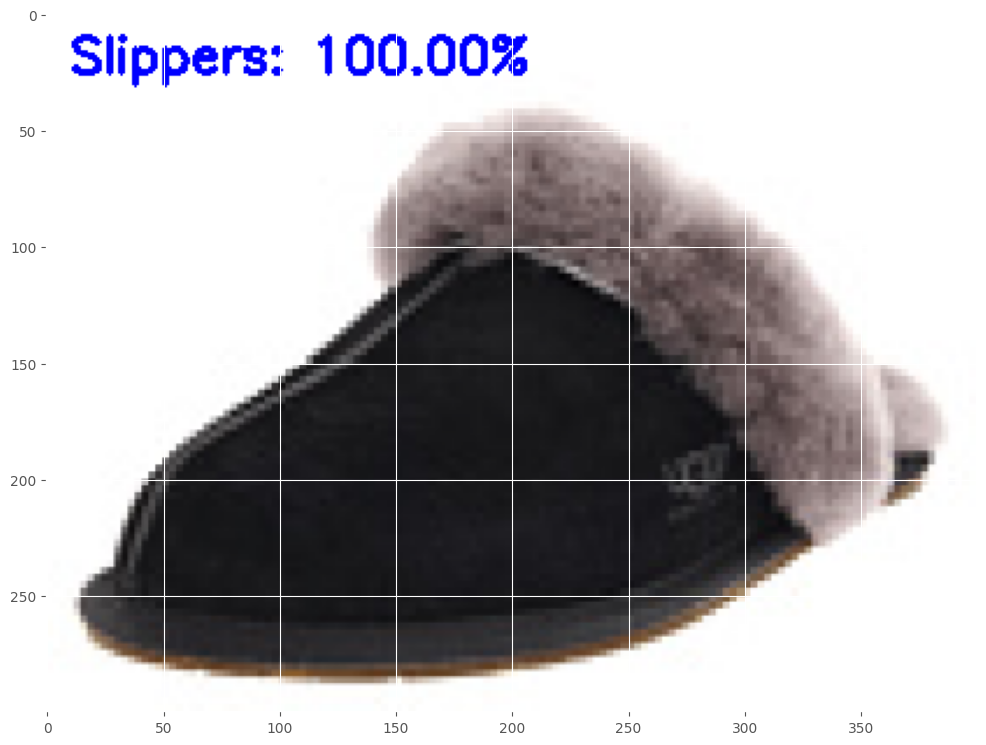

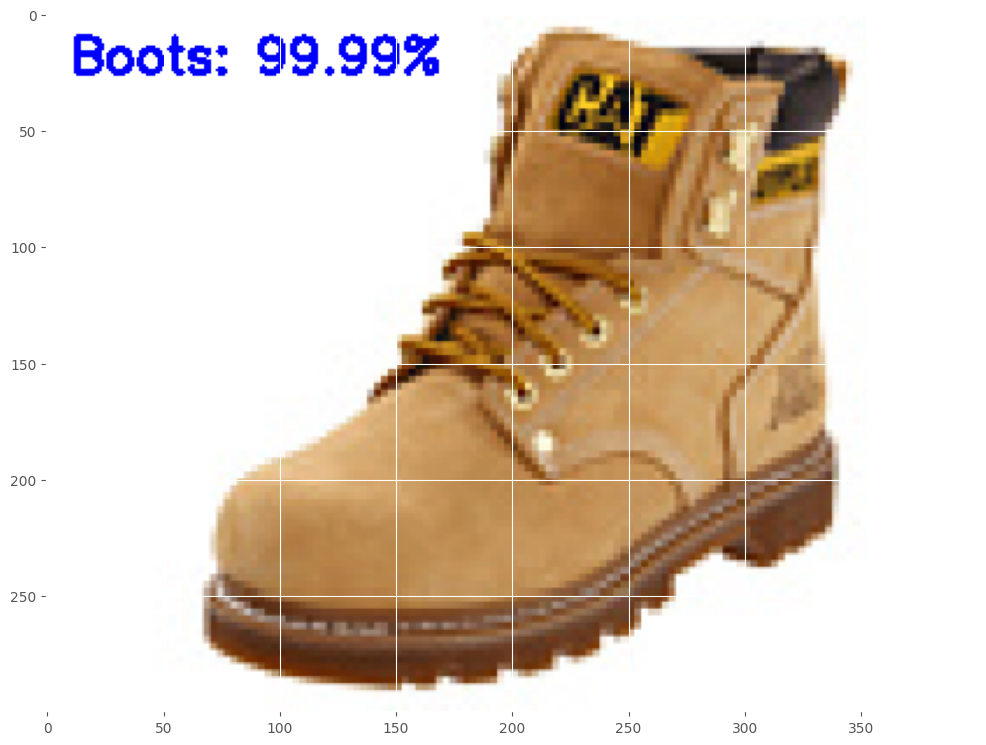

...

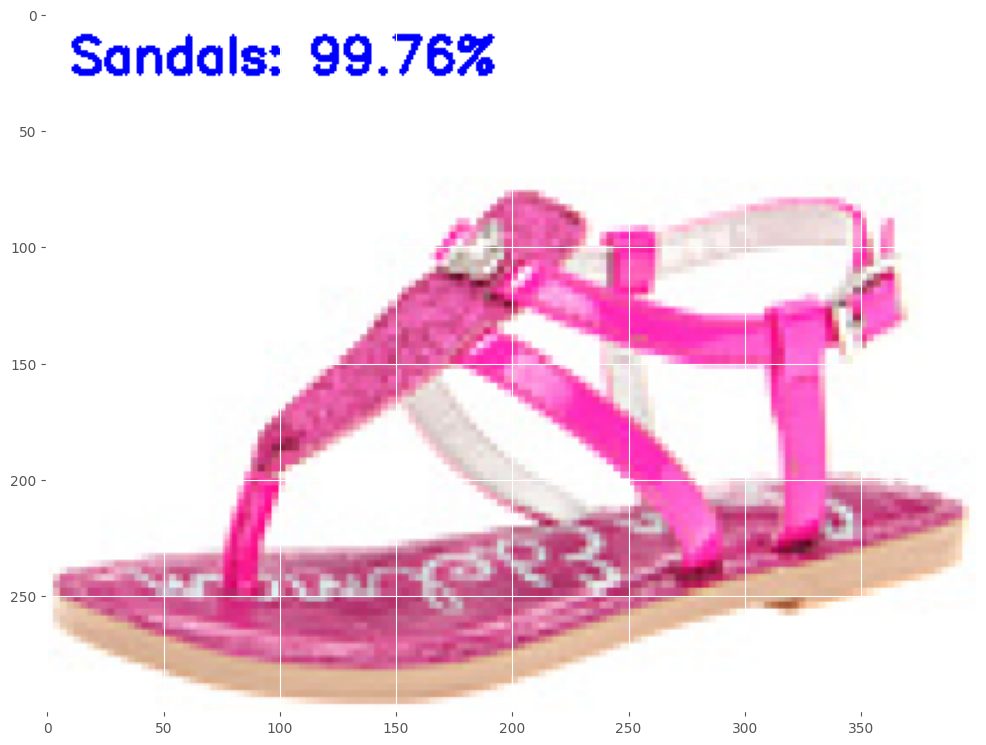

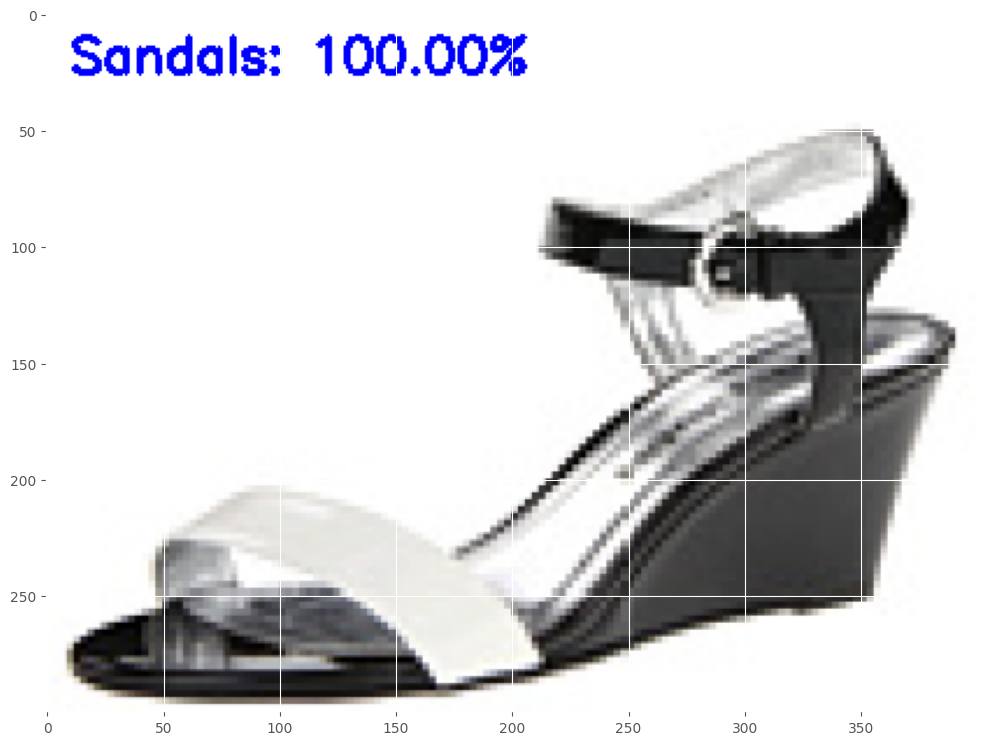

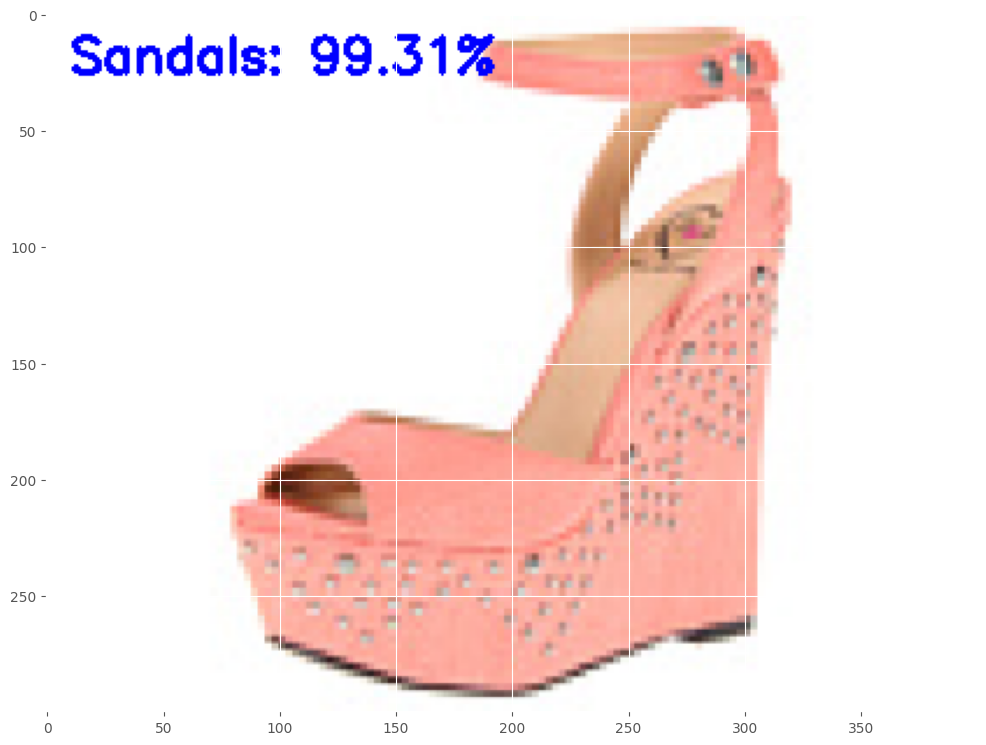

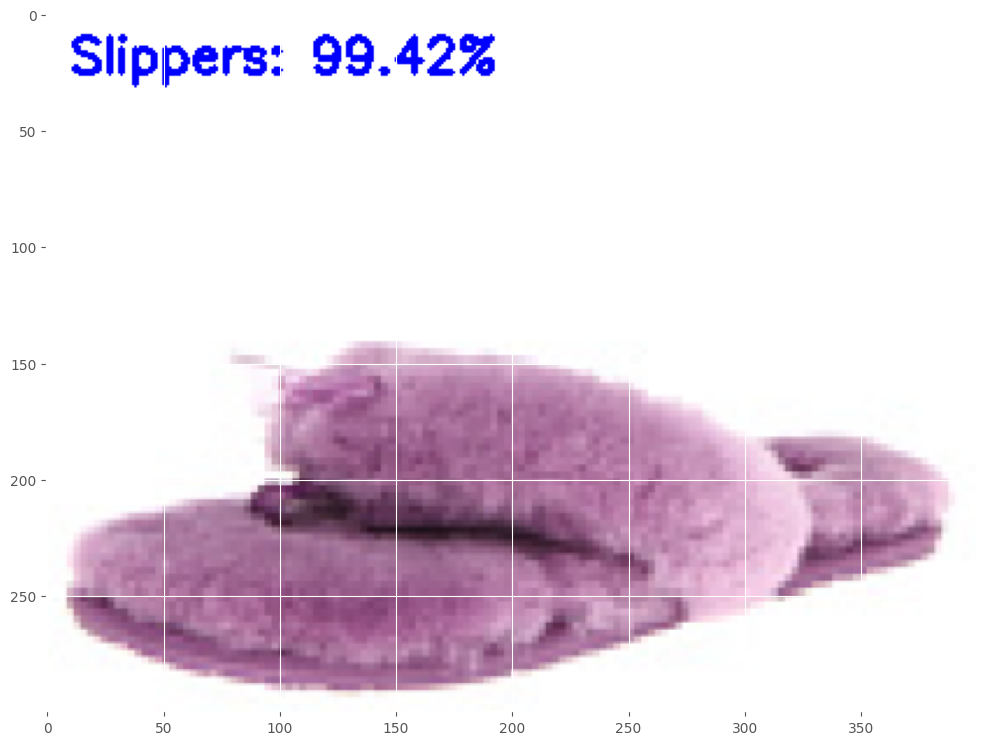

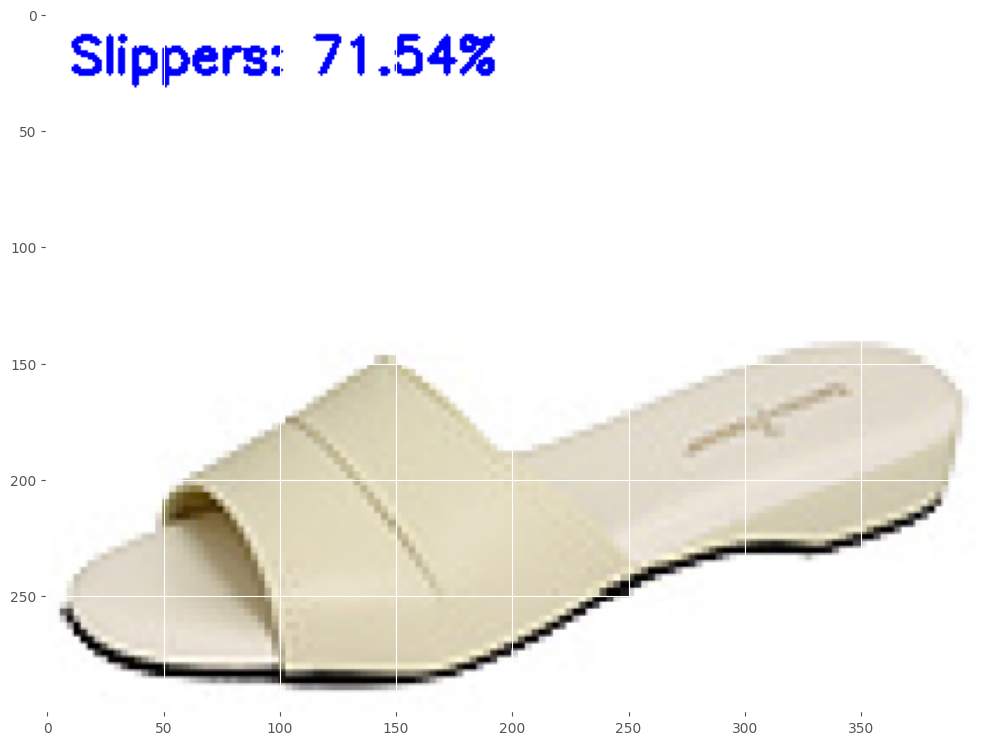

In [24]:
# grab the image paths and randomly shuffle themt
testImagePaths = sorted(list(paths.list_images('test_examples')))   # data folder with 2 categorical folders

all_class = ["Boots", "Sandals", "Slippers"]


# progress bar
with tqdm(total=len(testImagePaths)) as pbar:

    for imagePath in testImagePaths:

        # load the image
        image = cv2.imread(imagePath)
        orig = image.copy()

        # pre-process the image for classification
        image = cv2.resize(image, (28, 28))
        image = image.astype("float") / 255.0
        image = img_to_array(image)
        image = np.expand_dims(image, axis=0)

        # classify the input image
        prd_conf= model.predict(image)[0] # [[0.1 , 0.8 , 0.1]]
        print(prd_conf)

        # build the label
        label = all_class[np.argmax(prd_conf)] #[b f s]-> f
        proba = prd_conf[np.argmax(prd_conf)] # [0.1 , 0.8 , 0.1]  -> 0.8

        label = "{}: {:.2f}%".format(label, proba * 100)

        # draw the label on the image
        output = imutils.resize(orig, width=400)
        cv2.putText(output, label, (10, 25),  cv2.FONT_HERSHEY_SIMPLEX,
            0.7, (255, 0, 0), 2)

        # convert img to rgb format and display in notebook
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)

        pbar.update(1)